<a href="https://colab.research.google.com/github/BoonthichaSaejia/10days_basic_algorithm_course/blob/master/2143488_W12_Ensemble_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip -q install kora

     |████████████████████████████████| 61kB 2.9MB/s 
     |████████████████████████████████| 61kB 5.9MB/s 


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from kora import data_table
from kora import eda

NumExpr defaulting to 2 threads.


In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import normalize

In [ ]:
from sklearn.preprocessing import MultiLabelBinarizer

In [ ]:
from sklearn.cluster import KMeans

## **1 Data Preparation**

In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Data_for_MyColab/2143488_Big Data and Artificial Intelligence/HW3_movie_metadata.csv')
df.head(10)

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,movie_title,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,CCH Pounder,Avatar,886204,4834,Wes Studi,0.0,avatar|future|marine|native|paraplegic,http://www.imdb.com/title/tt0499549/?ref_=fn_t...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,Johnny Depp,Pirates of the Caribbean: At World's End,471220,48350,Jack Davenport,0.0,goddess|marriage ceremony|marriage proposal|pi...,http://www.imdb.com/title/tt0449088/?ref_=fn_t...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,Christoph Waltz,Spectre,275868,11700,Stephanie Sigman,1.0,bomb|espionage|sequel|spy|terrorist,http://www.imdb.com/title/tt2379713/?ref_=fn_t...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,Tom Hardy,The Dark Knight Rises,1144337,106759,Joseph Gordon-Levitt,0.0,deception|imprisonment|lawlessness|police offi...,http://www.imdb.com/title/tt1345836/?ref_=fn_t...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,Doug Walker,Star Wars: Episode VII - The Force Awakens ...,8,143,NaN,0.0,NaN,http://www.imdb.com/title/tt5289954/?ref_=fn_t...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0
5,Andrew Stanton,462.0,132.0,475.0,530.0,Samantha Morton,640.0,73058679.0,Action|Adventure|Sci-Fi,Daryl Sabara,John Carter,212204,1873,Polly Walker,1.0,alien|american civil war|male nipple|mars|prin...,http://www.imdb.com/title/tt0401729/?ref_=fn_t...,738.0,English,USA,PG-13,263700000.0,2012.0,632.0,6.6,2.35,24000
6,Sam Raimi,392.0,156.0,0.0,4000.0,James Franco,24000.0,336530303.0,Action|Adventure|Romance,J.K. Simmons,Spider-Man 3,383056,46055,Kirsten Dunst,0.0,sandman|spider man|symbiote|venom|villain,http://www.imdb.com/title/tt0413300/?ref_=fn_t...,1902.0,English,USA,PG-13,258000000.0,2007.0,11000.0,6.2,2.35,0
7,Nathan Greno,324.0,100.0,15.0,284.0,Donna Murphy,799.0,200807262.0,Adventure|Animation|Comedy|Family|Fantasy|Musi...,Brad Garrett,Tangled,294810,2036,M.C. Gainey,1.0,17th century|based on fairy tale|disney|flower...,http://www.imdb.com/title/tt0398286/?ref_=fn_t...,387.0,English,USA,PG,260000000.0,2010.0,553.0,7.8,1.85,29000
8,Joss Whedon,635.0,141.0,0.0,19000.0,Robert Downey Jr.,26000.0,458991599.0,Action|Adventure|Sci-Fi,Chris Hemsworth,Avengers: Age of Ultron,462669,92000,Scarlett Johansson,4.0,artificial intelligence|based on comic book|ca...,http://www.imdb.com/title/tt2395427/?ref_=fn_t...,1117.0,English,USA,PG-13,250000000.0,2015.0,21000.0,7.5,2.35,118000
9,David Yates,375.0,153.0,282.0,10000.0,Daniel Radcliffe,25000.0,301956980.0,Adventure|Family|Fantasy|Mystery,Alan Rickman,Harry Potter and the Half-Blood Prince,321795,58753,Rupert Grint,3.0,blood|book|love|potion|professor,http://www.imdb.com/title/tt0417741/?ref_=fn_t...,973.0,English,UK,PG,250000000.0,2009.0,11000.0,7.5,2.35,10000


DataPrep Report
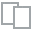
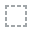
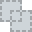
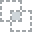
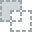
...
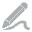
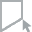
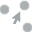
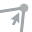
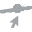

In [ ]:
eda.create_report(df)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 27 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   director_name              4939 non-null   object 
 1   num_critic_for_reviews     4993 non-null   float64
 2   duration                   5028 non-null   float64
 3   director_facebook_likes    4939 non-null   float64
 4   actor_3_facebook_likes     5020 non-null   float64
 5   actor_2_name               5030 non-null   object 
 6   actor_1_facebook_likes     5036 non-null   float64
 7   gross                      4159 non-null   float64
 8   genres                     5043 non-null   object 
 9   actor_1_name               5036 non-null   object 
 10  movie_title                5043 non-null   object 
 11  num_voted_users            5043 non-null   int64  
 12  cast_total_facebook_likes  5043 non-null   int64  
 13  actor_3_name               5020 non-null   objec

In [ ]:
drop_list_manyNull =[]
for i in df.columns:
  if len(df[df[i].isnull()==True])>len(df)*0.05:
    drop_list_manyNull.append(i)
print(drop_list_manyNull)

['gross', 'content_rating', 'budget', 'aspect_ratio']


In [ ]:
df=df.drop(drop_list_manyNull,axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   director_name              4939 non-null   object 
 1   num_critic_for_reviews     4993 non-null   float64
 2   duration                   5028 non-null   float64
 3   director_facebook_likes    4939 non-null   float64
 4   actor_3_facebook_likes     5020 non-null   float64
 5   actor_2_name               5030 non-null   object 
 6   actor_1_facebook_likes     5036 non-null   float64
 7   genres                     5043 non-null   object 
 8   actor_1_name               5036 non-null   object 
 9   movie_title                5043 non-null   object 
 10  num_voted_users            5043 non-null   int64  
 11  cast_total_facebook_likes  5043 non-null   int64  
 12  actor_3_name               5020 non-null   object 
 13  facenumber_in_poster       5030 non-null   float

In [ ]:
col = df.columns
for i in col:
  if df[i].dtype=='int64':
    arr = np.array(df[i])
    imp = SimpleImputer(missing_values=np.nan, strategy='mean')
    imp.fit(arr.reshape(-1, 1))
    SimpleImputer()
    df[i]=imp.transform(arr.reshape(-1, 1))
    df[i]=df[i].astype('int64')
  if df[i].dtype=='float64':
    arr = np.array(df[i])
    imp = SimpleImputer(missing_values=np.nan, strategy='mean')
    imp.fit(arr.reshape(-1, 1))
    SimpleImputer()
    df[i]=imp.transform(arr.reshape(-1, 1))
    df[i]=df[i].astype('float64')
df

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,genres,actor_1_name,movie_title,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,title_year,actor_2_facebook_likes,imdb_score,movie_facebook_likes
0,James Cameron,723.000000,178.000000,0.000000,855.000000,Joel David Moore,1000.0,Action|Adventure|Fantasy|Sci-Fi,CCH Pounder,Avatar,886204,4834,Wes Studi,0.0,avatar|future|marine|native|paraplegic,http://www.imdb.com/title/tt0499549/?ref_=fn_t...,3054.000000,English,USA,2009.000000,936.0,7.9,33000
1,Gore Verbinski,302.000000,169.000000,563.000000,1000.000000,Orlando Bloom,40000.0,Action|Adventure|Fantasy,Johnny Depp,Pirates of the Caribbean: At World's End,471220,48350,Jack Davenport,0.0,goddess|marriage ceremony|marriage proposal|pi...,http://www.imdb.com/title/tt0449088/?ref_=fn_t...,1238.000000,English,USA,2007.000000,5000.0,7.1,0
2,Sam Mendes,602.000000,148.000000,0.000000,161.000000,Rory Kinnear,11000.0,Action|Adventure|Thriller,Christoph Waltz,Spectre,275868,11700,Stephanie Sigman,1.0,bomb|espionage|sequel|spy|terrorist,http://www.imdb.com/title/tt2379713/?ref_=fn_t...,994.000000,English,UK,2015.000000,393.0,6.8,85000
3,Christopher Nolan,813.000000,164.000000,22000.000000,23000.000000,Christian Bale,27000.0,Action|Thriller,Tom Hardy,The Dark Knight Rises,1144337,106759,Joseph Gordon-Levitt,0.0,deception|imprisonment|lawlessness|police offi...,http://www.imdb.com/title/tt1345836/?ref_=fn_t...,2701.000000,English,USA,2012.000000,23000.0,8.5,164000
4,Doug Walker,140.194272,107.201074,131.000000,645.009761,Rob Walker,131.0,Documentary,Doug Walker,Star Wars: Episode VII - The Force Awakens ...,8,143,NaN,0.0,NaN,http://www.imdb.com/title/tt5289954/?ref_=fn_t...,272.770808,NaN,NaN,2002.470517,12.0,7.1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Scott Smith,1.000000,87.000000,2.000000,318.000000,Daphne Zuniga,637.0,Comedy|Drama,Eric Mabius,Signed Sealed Delivered,629,2283,Crystal Lowe,2.0,fraud|postal worker|prison|theft|trial,http://www.imdb.com/title/tt3000844/?ref_=fn_t...,6.000000,English,Canada,2013.000000,470.0,7.7,84
5039,NaN,43.000000,43.000000,686.509212,319.000000,Valorie Curry,841.0,Crime|Drama|Mystery|Thriller,Natalie Zea,The Following,73839,1753,Sam Underwood,1.0,cult|fbi|hideout|prison escape|serial killer,http://www.imdb.com/title/tt2071645/?ref_=fn_t...,359.000000,English,USA,2002.470517,593.0,7.5,32000
5040,Benjamin Roberds,13.000000,76.000000,0.000000,0.000000,Maxwell Moody,0.0,Drama|Horror|Thriller,Eva Boehnke,A Plague So Pleasant,38,0,David Chandler,0.0,NaN,http://www.imdb.com/title/tt2107644/?ref_=fn_t...,3.000000,English,USA,2013.000000,0.0,6.3,16
5041,Daniel Hsia,14.000000,100.000000,0.000000,489.000000,Daniel Henney,946.0,Comedy|Drama|Romance,Alan Ruck,Shanghai Calling,1255,2386,Eliza Coupe,5.0,NaN,http://www.imdb.com/title/tt2070597/?ref_=fn_t...,9.000000,English,USA,2012.000000,719.0,6.3,660


In [ ]:
df.title_year = df.title_year.astype('int64')
df.num_critic_for_reviews = df.num_critic_for_reviews.astype('int64')
df.director_facebook_likes= df.director_facebook_likes.astype('int64')
df.actor_3_facebook_likes = df.actor_3_facebook_likes.astype('int64')
df.actor_2_facebook_likes = df.actor_2_facebook_likes.astype('int64')
df.actor_1_facebook_likes = df.actor_1_facebook_likes.astype('int64')
df.facenumber_in_poster   = df.facenumber_in_poster.astype('int64')
df.num_user_for_reviews   = df.num_user_for_reviews.astype('int64')
df.movie_facebook_likes   = df.movie_facebook_likes.astype('int64')
df.duration               = df.duration.astype('int64')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   director_name              4939 non-null   object 
 1   num_critic_for_reviews     5043 non-null   int64  
 2   duration                   5043 non-null   int64  
 3   director_facebook_likes    5043 non-null   int64  
 4   actor_3_facebook_likes     5043 non-null   int64  
 5   actor_2_name               5030 non-null   object 
 6   actor_1_facebook_likes     5043 non-null   int64  
 7   genres                     5043 non-null   object 
 8   actor_1_name               5036 non-null   object 
 9   movie_title                5043 non-null   object 
 10  num_voted_users            5043 non-null   int64  
 11  cast_total_facebook_likes  5043 non-null   int64  
 12  actor_3_name               5020 non-null   object 
 13  facenumber_in_poster       5043 non-null   int64

In [ ]:
df_new = df.drop(['movie_imdb_link','movie_title','actor_1_name','actor_2_name','actor_3_name'],axis=1)
df_new['plot_keywords'] = df_new['plot_keywords'].replace(np.nan,'none')
for i in range(len(df_new)):
  if df_new.at[i,'genres']!=np.nan:
    df_new.at[i,'genres'] = df_new.at[i,'genres'].split('|')
  df_new.at[i,'plot_keywords'] = df_new.at[i,'plot_keywords'].split('|')
df_new

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,genres,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,plot_keywords,num_user_for_reviews,language,country,title_year,actor_2_facebook_likes,imdb_score,movie_facebook_likes
0,James Cameron,723,178,0,855,1000,"[Action, Adventure, Fantasy, Sci-Fi]",886204,4834,0,"[avatar, future, marine, native, paraplegic]",3054,English,USA,2009,936,7.9,33000
1,Gore Verbinski,302,169,563,1000,40000,"[Action, Adventure, Fantasy]",471220,48350,0,"[goddess, marriage ceremony, marriage proposal...",1238,English,USA,2007,5000,7.1,0
2,Sam Mendes,602,148,0,161,11000,"[Action, Adventure, Thriller]",275868,11700,1,"[bomb, espionage, sequel, spy, terrorist]",994,English,UK,2015,393,6.8,85000
3,Christopher Nolan,813,164,22000,23000,27000,"[Action, Thriller]",1144337,106759,0,"[deception, imprisonment, lawlessness, police ...",2701,English,USA,2012,23000,8.5,164000
4,Doug Walker,140,107,131,645,131,[Documentary],8,143,0,[none],272,NaN,NaN,2002,12,7.1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Scott Smith,1,87,2,318,637,"[Comedy, Drama]",629,2283,2,"[fraud, postal worker, prison, theft, trial]",6,English,Canada,2013,470,7.7,84
5039,NaN,43,43,686,319,841,"[Crime, Drama, Mystery, Thriller]",73839,1753,1,"[cult, fbi, hideout, prison escape, serial kil...",359,English,USA,2002,593,7.5,32000
5040,Benjamin Roberds,13,76,0,0,0,"[Drama, Horror, Thriller]",38,0,0,[none],3,English,USA,2013,0,6.3,16
5041,Daniel Hsia,14,100,0,489,946,"[Comedy, Drama, Romance]",1255,2386,5,[none],9,English,USA,2012,719,6.3,660


In [ ]:
english_movie = []
for i in range(len(df_new)):
  if df_new.at[i,'language']=='English':
    english_movie.append(1)
  else:
    english_movie.append(0)
df_new['english_language']=english_movie
df_new = df_new.drop('language',axis=1)
df_new.head()

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,genres,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,plot_keywords,num_user_for_reviews,country,title_year,actor_2_facebook_likes,imdb_score,movie_facebook_likes,english_language
0,James Cameron,723,178,0,855,1000,"[Action, Adventure, Fantasy, Sci-Fi]",886204,4834,0,"[avatar, future, marine, native, paraplegic]",3054,USA,2009,936,7.9,33000,1
1,Gore Verbinski,302,169,563,1000,40000,"[Action, Adventure, Fantasy]",471220,48350,0,"[goddess, marriage ceremony, marriage proposal...",1238,USA,2007,5000,7.1,0,1
2,Sam Mendes,602,148,0,161,11000,"[Action, Adventure, Thriller]",275868,11700,1,"[bomb, espionage, sequel, spy, terrorist]",994,UK,2015,393,6.8,85000,1
3,Christopher Nolan,813,164,22000,23000,27000,"[Action, Thriller]",1144337,106759,0,"[deception, imprisonment, lawlessness, police ...",2701,USA,2012,23000,8.5,164000,1
4,Doug Walker,140,107,131,645,131,[Documentary],8,143,0,[none],272,NaN,2002,12,7.1,0,0


In [ ]:
df_new = df_new.replace(np.nan,'Unknown')
df_new

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,genres,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,plot_keywords,num_user_for_reviews,country,title_year,actor_2_facebook_likes,imdb_score,movie_facebook_likes,english_language
0,James Cameron,723,178,0,855,1000,"[Action, Adventure, Fantasy, Sci-Fi]",886204,4834,0,"[avatar, future, marine, native, paraplegic]",3054,USA,2009,936,7.9,33000,1
1,Gore Verbinski,302,169,563,1000,40000,"[Action, Adventure, Fantasy]",471220,48350,0,"[goddess, marriage ceremony, marriage proposal...",1238,USA,2007,5000,7.1,0,1
2,Sam Mendes,602,148,0,161,11000,"[Action, Adventure, Thriller]",275868,11700,1,"[bomb, espionage, sequel, spy, terrorist]",994,UK,2015,393,6.8,85000,1
3,Christopher Nolan,813,164,22000,23000,27000,"[Action, Thriller]",1144337,106759,0,"[deception, imprisonment, lawlessness, police ...",2701,USA,2012,23000,8.5,164000,1
4,Doug Walker,140,107,131,645,131,[Documentary],8,143,0,[none],272,Unknown,2002,12,7.1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Scott Smith,1,87,2,318,637,"[Comedy, Drama]",629,2283,2,"[fraud, postal worker, prison, theft, trial]",6,Canada,2013,470,7.7,84,1
5039,Unknown,43,43,686,319,841,"[Crime, Drama, Mystery, Thriller]",73839,1753,1,"[cult, fbi, hideout, prison escape, serial kil...",359,USA,2002,593,7.5,32000,1
5040,Benjamin Roberds,13,76,0,0,0,"[Drama, Horror, Thriller]",38,0,0,[none],3,USA,2013,0,6.3,16,1
5041,Daniel Hsia,14,100,0,489,946,"[Comedy, Drama, Romance]",1255,2386,5,[none],9,USA,2012,719,6.3,660,1


In [ ]:
mlb = MultiLabelBinarizer()
df_genres=pd.DataFrame(mlb.fit_transform(df_new['genres']),columns='Genres_'+mlb.classes_, index=df_new.index)
df_genres

,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,Genres_War,Genres_Western
0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5039,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0
5040,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
5041,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [ ]:
df_new=df_new.join(df_genres)
df_new=df_new.drop(['genres','plot_keywords','country','director_name'],axis=1)
df_new=pd.get_dummies(df_new)
df_new

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,title_year,actor_2_facebook_likes,imdb_score,movie_facebook_likes,english_language,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,Genres_War,Genres_Western
0,723,178,0,855,1000,886204,4834,0,3054,2009,936,7.9,33000,1,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,302,169,563,1000,40000,471220,48350,0,1238,2007,5000,7.1,0,1,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,602,148,0,161,11000,275868,11700,1,994,2015,393,6.8,85000,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,813,164,22000,23000,27000,1144337,106759,0,2701,2012,23000,8.5,164000,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
4,140,107,131,645,131,8,143,0,272,2002,12,7.1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,1,87,2,318,637,629,2283,2,6,2013,470,7.7,84,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5039,43,43,686,319,841,73839,1753,1,359,2002,593,7.5,32000,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0
5040,13,76,0,0,0,38,0,0,3,2013,0,6.3,16,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
5041,14,100,0,489,946,1255,2386,5,9,2012,719,6.3,660,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [ ]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 40 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   num_critic_for_reviews     5043 non-null   int64  
 1   duration                   5043 non-null   int64  
 2   director_facebook_likes    5043 non-null   int64  
 3   actor_3_facebook_likes     5043 non-null   int64  
 4   actor_1_facebook_likes     5043 non-null   int64  
 5   num_voted_users            5043 non-null   int64  
 6   cast_total_facebook_likes  5043 non-null   int64  
 7   facenumber_in_poster       5043 non-null   int64  
 8   num_user_for_reviews       5043 non-null   int64  
 9   title_year                 5043 non-null   int64  
 10  actor_2_facebook_likes     5043 non-null   int64  
 11  imdb_score                 5043 non-null   float64
 12  movie_facebook_likes       5043 non-null   int64  
 13  english_language           5043 non-null   int64

In [ ]:
x = df_new.drop('imdb_score',axis=1)
y = df_new['imdb_score']

#### Normalized Attributes

In [ ]:
for i in x.columns:
  x_array = np.array(x[i])
  normalized_arr = normalize([x_array])
  x[i]=normalized_arr[0]
x

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,title_year,actor_2_facebook_likes,movie_facebook_likes,english_language,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,Genres_War,Genres_Western
0,0.054980,0.022763,0.000000,0.006757,0.000860,7.713441e-02,0.003306,0.000000,0.092394,0.014127,0.003022,0.022414,0.01458,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.040489,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.040291,0.0,0.0,0.000000,0.0,0.0
1,0.022965,0.021612,0.002765,0.007903,0.034388,4.101457e-02,0.033068,0.000000,0.037454,0.014113,0.016143,0.000000,0.01458,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.040489,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0
2,0.045778,0.018927,0.000000,0.001272,0.009457,2.401131e-02,0.008002,0.005787,0.030072,0.014170,0.001269,0.057732,0.01458,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,0.0
3,0.061824,0.020973,0.108046,0.181760,0.023212,9.960208e-02,0.073015,0.000000,0.081715,0.014149,0.074256,0.111389,0.01458,0.02945,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,0.0
4,0.010646,0.013684,0.000643,0.005097,0.000113,6.963129e-07,0.000098,0.000000,0.008229,0.014078,0.000039,0.000000,0.00000,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.090909,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,0.000076,0.011126,0.000010,0.002513,0.000548,5.474760e-05,0.001561,0.011574,0.000182,0.014156,0.001517,0.000057,0.01458,0.00000,0.000000,0.0,0.0,0.023113,0.000000,0.000000,0.019634,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0
5039,0.003270,0.005499,0.003369,0.002521,0.000723,6.426881e-03,0.001199,0.005787,0.010861,0.014078,0.001915,0.021734,0.01458,0.00000,0.000000,0.0,0.0,0.000000,0.033539,0.000000,0.019634,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.044721,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,0.0
5040,0.000989,0.009719,0.000000,0.000000,0.000000,3.307486e-06,0.000000,0.000000,0.000091,0.014156,0.000000,0.000011,0.01458,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.019634,0.0,0.000000,0.0,0.0,0.0,0.04207,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,0.0
5041,0.001065,0.012788,0.000000,0.003864,0.000813,1.092341e-04,0.001632,0.028935,0.000272,0.014149,0.002321,0.000448,0.01458,0.00000,0.000000,0.0,0.0,0.023113,0.000000,0.000000,0.019634,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.030056,0.000000,0.0,0.0,0.000000,0.0,0.0


#### Calculate imdb_1 (Low or High)

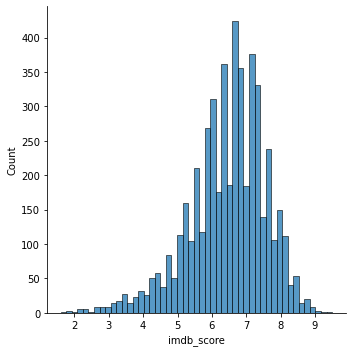

In [ ]:
sns.displot(y)

In [ ]:
y.mean()

6.442137616498111

In [ ]:
label_median=y.median()

## **2 Data Visualization and Analytics**

In [ ]:
for i in range(len(y)):
  if y[i]>label_median:
    y[i]='High'
  else:
    y[i]='Low'

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vie

In [ ]:
y

0       High
1       High
2       High
3       High
4       High
        ... 
5038    High
5039    High
5040     Low
5041     Low
5042     Low
Name: imdb_score, Length: 5043, dtype: object

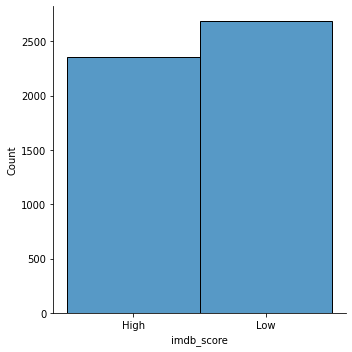

In [ ]:
sns.displot(y)

## **3 Ensemble Methods**

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
y = np.array(y).reshape(-1, 1)

In [ ]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.3,random_state=69)

In [ ]:
print('x_train:',x_train.shape)
print('y_train:',y_train.shape)
print('x_test:', x_test.shape)
print('y_test:', y_test.shape)

x_train: (3530, 39)
y_train: (3530, 1)
x_test: (1513, 39)
y_test: (1513, 1)


### **3.1 Logistic Regression**

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
lr = LogisticRegression()
lr.fit(x_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [ ]:
lr_predicted = lr.predict(x_test)

### **3.2 Decision Tree**

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
dtree = DecisionTreeClassifier()
dtree.fit(x_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [ ]:
dt_predicted = dtree.predict(x_test)

### **3.3 K-NN**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
knn = KNeighborsClassifier()
knn.fit(x_train, y_train)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [ ]:
knn_predicted = knn.predict(x_test)

### **3.4 SVM**

In [ ]:
from sklearn.svm import SVC

In [ ]:
svc = SVC()
svc.fit(x_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

In [ ]:
svc_predicted = svc.predict(x_test)

### Voting

In [ ]:
from sklearn.ensemble import VotingClassifier

In [ ]:
eclf1 = VotingClassifier(estimators=[('lr', lr), ('dt', dtree), ('knn', knn),('svc',svc)],
                         voting='hard')
eclf1 = eclf1.fit(x_train, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:235: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:268: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [ ]:
predicted=eclf1.predict(x_test)

## **4 Evaluation**

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score,accuracy_score

In [ ]:
confusion_matrix(y_test,predicted)

array([[476, 211],
       [157, 669]])

In [ ]:
confusion_matrix(y_test,lr_predicted)

array([[251, 436],
       [ 50, 776]])

In [ ]:
print('accuracy for voting method       :',accuracy_score(y_test,predicted))
print('accuracy for logistic regression :',accuracy_score(y_test,lr_predicted))
print('accuracy for decision tree       :',accuracy_score(y_test,dt_predicted))
print('accuracy for k-nearest neighbour :',accuracy_score(y_test,knn_predicted))
print('accuracy for svm                 :',accuracy_score(y_test,svc_predicted))

accuracy for voting method       : 0.7567746199603437
accuracy for logistic regression : 0.6787838730998017
accuracy for decision tree       : 0.7290152015862524
accuracy for k-nearest neighbour : 0.6906807666886979
accuracy for svm                 : 0.7468605419695968
